# Imports

In [6]:
#data manipulation
import numpy as np
import pandas as pd

#visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns

#handle warnings
import warnings
warnings.filterwarnings(action='ignore',category=DeprecationWarning)
warnings.filterwarnings(action='ignore',category=FutureWarning)

# Read Data

In [7]:
sales_train = pd.read_csv('../data/sales_train.csv', delimiter=',')

In [8]:
sales_train.head()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
0,02.01.2013,0,59,22154,999.00,1.0
1,03.01.2013,0,25,2552,899.00,1.0
2,05.01.2013,0,25,2552,899.00,-1.0
3,06.01.2013,0,25,2554,1709.05,1.0
4,15.01.2013,0,25,2555,1099.00,1.0


In [9]:
sales_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2935849 entries, 0 to 2935848
Data columns (total 6 columns):
 #   Column          Dtype  
---  ------          -----  
 0   date            object 
 1   date_block_num  int64  
 2   shop_id         int64  
 3   item_id         int64  
 4   item_price      float64
 5   item_cnt_day    float64
dtypes: float64(2), int64(3), object(1)
memory usage: 134.4+ MB


In [10]:
#check null values
sales_train.isnull().sum()

date              0
date_block_num    0
shop_id           0
item_id           0
item_price        0
item_cnt_day      0
dtype: int64

# Preprosseing the data

In [11]:
# check duplicates
len(sales_train[sales_train.duplicated()==True])

6

In [12]:
# drop the duplicates from the dataset
sales_train.drop_duplicates(keep='first',inplace=True)

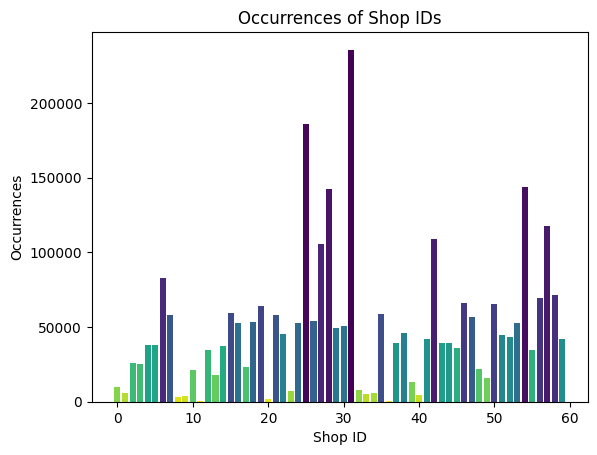

In [13]:
shop_id_counts = sales_train['shop_id'].value_counts().sort_values(ascending=False)
plt.bar(shop_id_counts.index, shop_id_counts.values, color=plt.cm.viridis(np.linspace(0, 1, len(shop_id_counts))))
plt.xlabel('Shop ID')
plt.ylabel('Occurrences')
plt.title('Occurrences of Shop IDs')
plt.show()

In [14]:
# changing date format and add additional columns
sales_train['date'] = pd.to_datetime(sales_train['date'],format='%d.%m.%Y')

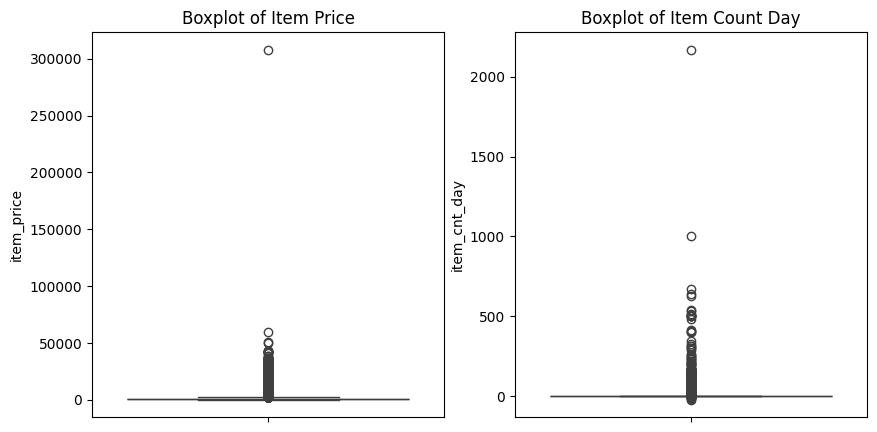

In [18]:
# plot the boxplot of item_price and item_cnt_day
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.boxplot(sales_train['item_price'])
plt.title('Boxplot of Item Price')

plt.subplot(1,2,2)
sns.boxplot(sales_train['item_cnt_day'])
plt.title('Boxplot of Item Count Day')
plt.show()

In [19]:
sales_train[sales_train['item_price']>300000]

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
1163158,2013-12-13,11,12,6066,307980.0,1.0


In [20]:
np.min(sales_train['item_price'])

-1.0

In [21]:
np.max(sales_train['item_price'])

307980.0

In [22]:
sales_train['item_cnt_day'].describe()

count    2.935843e+06
mean     1.242641e+00
std      2.618837e+00
min     -2.200000e+01
25%      1.000000e+00
50%      1.000000e+00
75%      1.000000e+00
max      2.169000e+03
Name: item_cnt_day, dtype: float64

In [23]:
np.min(sales_train['item_cnt_day'])

-22.0

In [24]:
sales_train[sales_train['item_cnt_day']<0]['shop_id']

2          25
148        25
175        25
807        25
1041       25
           ..
2934243    25
2934462    25
2935263    25
2935643    25
2935779    25
Name: shop_id, Length: 7356, dtype: int64

In [25]:
# replace the negative item cnt with 0 
sales_train['item_cnt_day'].mask(sales_train['item_cnt_day'] <0.0 ,0.0, inplace=True)

In [26]:
# delete the row where the item price is negative
sales_train.drop([sales_train[sales_train['item_price']<0].index[0]],inplace=True)

In [27]:
# Delete outliers
Q1 = np.percentile(sales_train['item_price'], 25,
                   interpolation = 'midpoint')
 
Q3 = np.percentile(sales_train['item_price'], 75,
                   interpolation = 'midpoint')
IQR = Q3 - Q1
 
print("Old Shape: ", sales_train.shape)
 
# Upper bound
upper = np.where(sales_train['item_price'] >= (Q3+1.5*IQR))
# Lower bound
lower = np.where(sales_train['item_price'] <= (Q1-1.5*IQR))
 
#remove the outliers
sales_train.drop(upper[0], inplace = True)
sales_train.drop(lower[0], inplace = True)

Old Shape:  (2935842, 6)


In [28]:
print("New Shape: ", sales_train.shape)

New Shape:  (2676856, 6)


In [29]:
# order the data by date
sales_train.sort_values(by='date',inplace=True)

# Creating new Columns

In [30]:
sales_train['sales'] = sales_train['item_price']*sales_train['item_cnt_day']

In [31]:
sales_train['year'] = pd.DatetimeIndex(sales_train['date']).year
sales_train['month'] = pd.DatetimeIndex(sales_train['date']).month

In [32]:
sales_train.head(5)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,sales,year,month
47497,2013-01-01,0,15,2308,799.0,1.0,799.0,2013,1
108140,2013-01-01,0,37,11456,149.0,1.0,149.0,2013,1
17551,2013-01-01,0,27,19129,299.0,1.0,299.0,2013,1
17530,2013-01-01,0,27,19473,249.0,1.0,249.0,2013,1
17517,2013-01-01,0,27,19221,199.0,1.0,199.0,2013,1


In [33]:
# reorganize the columns
sales_train = sales_train[['date','year','month','date_block_num', 'shop_id','item_id','item_price','item_cnt_day','sales']]

In [34]:
sales_train.head(5)

,date,year,month,date_block_num,shop_id,item_id,item_price,item_cnt_day,sales
47497,2013-01-01,2013,1,0,15,2308,799.0,1.0,799.0
108140,2013-01-01,2013,1,0,37,11456,149.0,1.0,149.0
17551,2013-01-01,2013,1,0,27,19129,299.0,1.0,299.0
17530,2013-01-01,2013,1,0,27,19473,249.0,1.0,249.0
17517,2013-01-01,2013,1,0,27,19221,199.0,1.0,199.0


# Time Series Analysis

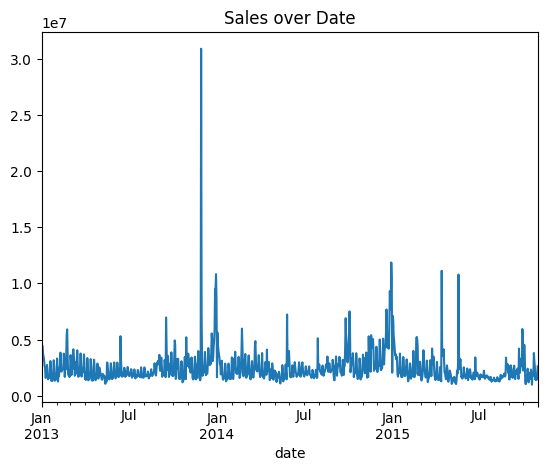

In [35]:
sales_train.groupby('date')['sales'].sum().plot()
plt.title('Sales over Date')
plt.show()

In [36]:
# Removing Outliers
final = sales_train[(sales_train['item_cnt_day']>0)&(sales_train['item_cnt_day'] < sales_train['item_cnt_day'].quantile(0.96))]

In [37]:
final = final[(final['item_price'] > 0)&(final['item_price']<final['item_price'].quantile(0.92))]

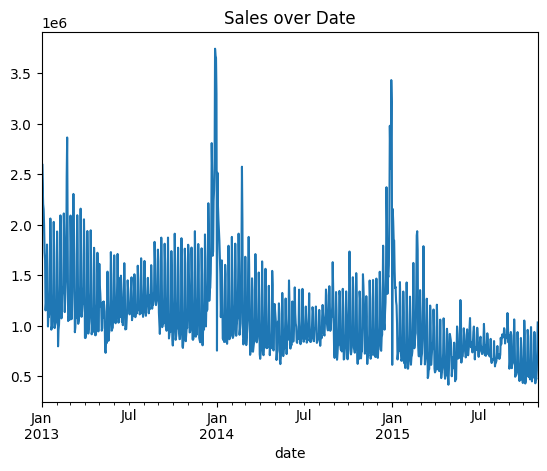

In [38]:
final.groupby('date')['sales'].sum().plot()
plt.title('Sales over Date')
plt.show()

In [39]:
fig = px.histogram(final, x='item_price', title='Frequency of Sales over the Years')
fig.show()

In [41]:
# create a column for item_cnt_month
final['item_cnt_month'] = final.groupby(['shop_id','item_id','date_block_num'])['item_cnt_day'].transform('sum')

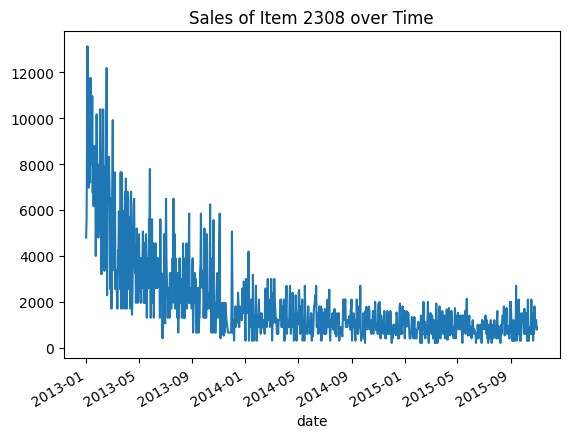

In [42]:
item_id = 2308
# plot the item sales over time
final[final['item_id']==item_id].groupby('date')['sales'].sum().plot()
plt.title(f'Sales of Item {item_id} over Time')
plt.show()

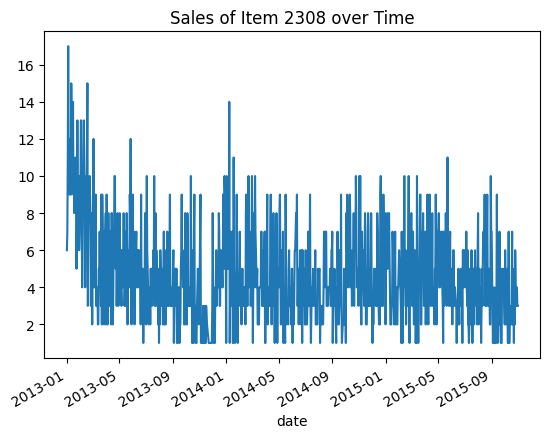

In [43]:
item_id = 2308
# plot the item sales over time
final[final['item_id']==item_id].groupby('date')['item_cnt_day'].sum().plot()
plt.title(f'Sales of Item {item_id} over Time')
plt.show()

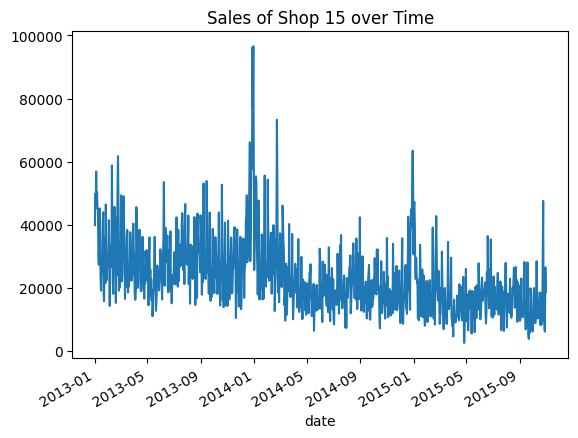

In [44]:
shop_id = 15
# plot the item sales over time
final[final['shop_id']==shop_id].groupby('date')['sales'].sum().plot()
plt.title(f'Sales of Shop {shop_id} over Time')
plt.show()

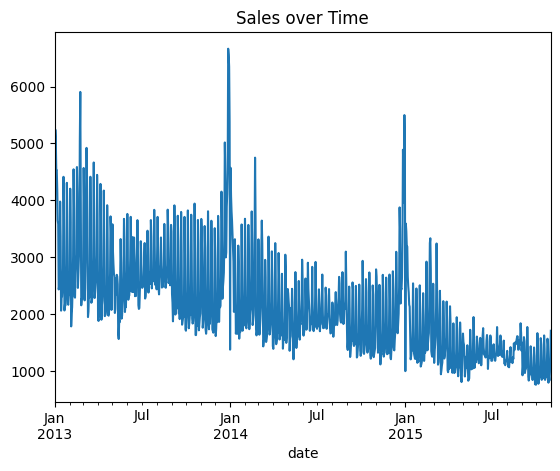

In [45]:
# plot the item_cnt_day over time in general
final.groupby('date')['item_cnt_day'].sum().plot()
plt.title('Sales over Time')
plt.show()

# Statioanrity tests : exploring log, boxcox, fourier and diff transfomation

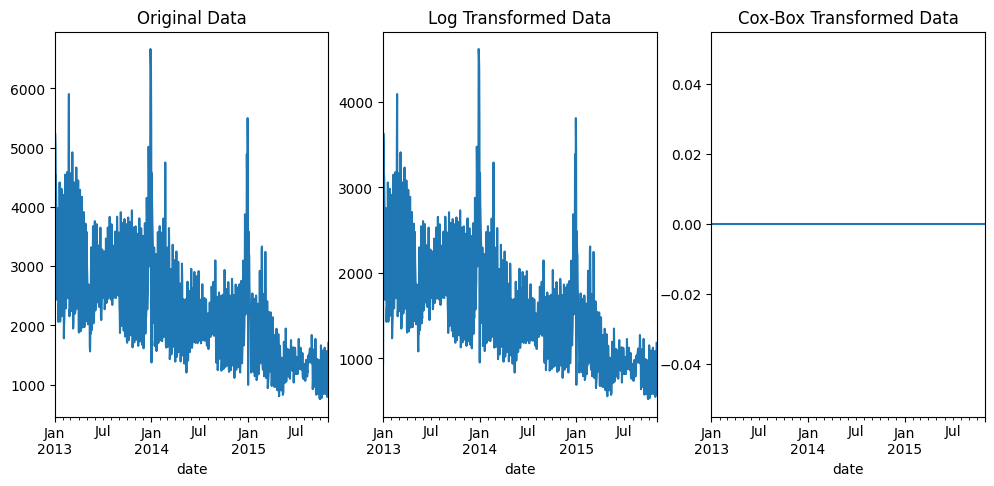

In [46]:
x = final.copy()
## sort the data by date
x.sort_values(by='date',inplace=True)

# use the log transformation to make the data stationary
x['item_cnt_day_log'] = np.log1p(x['item_cnt_day'])

# use the cox-box transformation to make the data stationary
from scipy import stats
x['item_cnt_day_cox'] = stats.boxcox(x['item_cnt_day'],lmbda=0.0)

# plot the original and the transformed data
plt.figure(figsize=(12,5))
plt.subplot(1,3,1)
x.groupby('date')['item_cnt_day'].sum().plot()
plt.title('Original Data')

plt.subplot(1,3,2)
x.groupby('date')['item_cnt_day_log'].sum().plot()
plt.title('Log Transformed Data')

plt.subplot(1,3,3)
x.groupby('date')['item_cnt_day_cox'].sum().plot()
plt.title('Cox-Box Transformed Data')

plt.show()

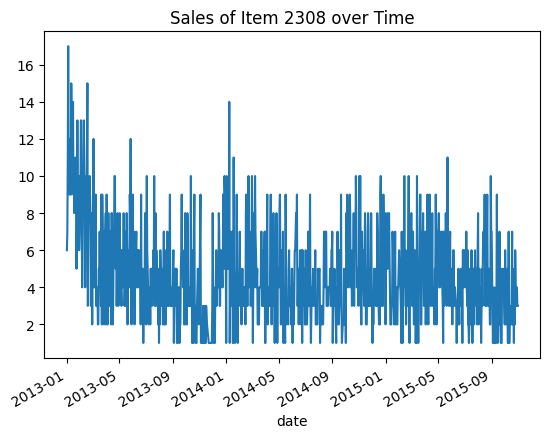

In [47]:
item_id = 2308
# plot the item sales over time
x[x['item_id']==item_id].groupby('date')['item_cnt_day'].sum().plot()
plt.title(f'Sales of Item {item_id} over Time')
plt.show()

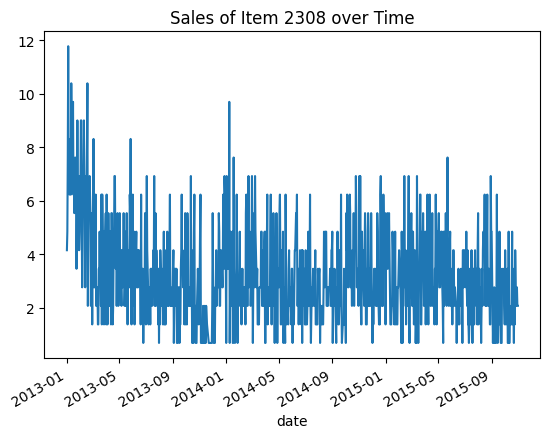

In [48]:
item_id = 2308
# plot the item sales over time
x[x['item_id']==item_id].groupby('date')['item_cnt_day_log'].sum().plot()
plt.title(f'Sales of Item {item_id} over Time')
plt.show()

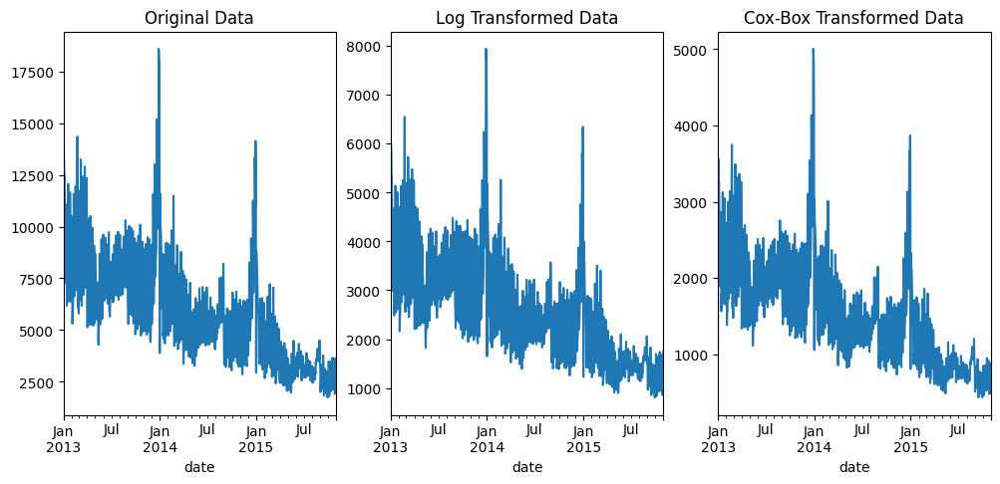

In [49]:
# use the log transformation to make the data stationary
x['item_cnt_month_log'] = np.log1p(x['item_cnt_month'])

x['item_cnt_month_cox'] = stats.boxcox(x['item_cnt_month'], lmbda=0.0)

# plot the original and the transformed data
plt.figure(figsize=(12, 5))
plt.subplot(1, 3, 1)
x.groupby('date')['item_cnt_month'].sum().plot()
plt.title('Original Data')

plt.subplot(1, 3, 2)
x.groupby('date')['item_cnt_month_log'].sum().plot()
plt.title('Log Transformed Data')

plt.subplot(1, 3, 3)
x.groupby('date')['item_cnt_month_cox'].sum().plot()
plt.title('Cox-Box Transformed Data')

plt.show()

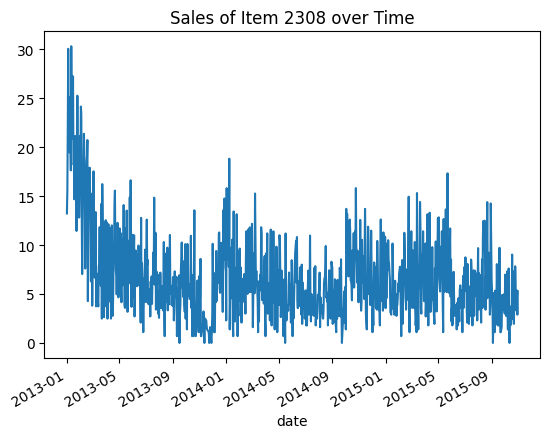

In [50]:
item_id = 2308
# plot the item sales over time
x[x['item_id']==item_id].groupby('date')['item_cnt_month_cox'].sum().plot()
plt.title(f'Sales of Item {item_id} over Time')
plt.show()

In [51]:
from scipy.fftpack import fft, ifft

# Check if 'item_cnt_month' column exists in the DataFrame
if 'item_cnt_month' in x.columns:
    # Convert to NumPy array to ensure compatibility with SciPy
    item_cnt_month_array = x['item_cnt_month'].to_numpy()

    # Apply the Fourier transformation
    x['item_cnt_month_fourier'] = fft(item_cnt_month_array)


/Users/ilyeslenoob/Sales-Prediction-with-Deep-Learning/venv/lib/python3.13/site-packages/matplotlib/cbook.py:1699: ComplexWarning:

Casting complex values to real discards the imaginary part

/Users/ilyeslenoob/Sales-Prediction-with-Deep-Learning/venv/lib/python3.13/site-packages/matplotlib/cbook.py:1345: ComplexWarning:

Casting complex values to real discards the imaginary part



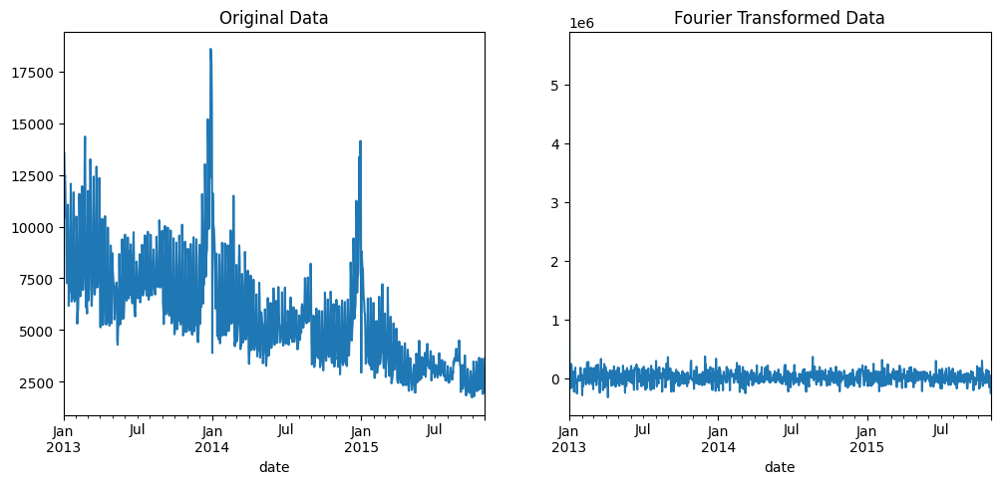

In [52]:
# plot the original and the transformed data
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
x.groupby('date')['item_cnt_month'].sum().plot()
plt.title('Original Data')

plt.subplot(1,2,2)
x.groupby('date')['item_cnt_month_fourier'].sum().plot()
plt.title('Fourier Transformed Data')

plt.show()

/Users/ilyeslenoob/Sales-Prediction-with-Deep-Learning/venv/lib/python3.13/site-packages/matplotlib/cbook.py:1699: ComplexWarning:

Casting complex values to real discards the imaginary part

/Users/ilyeslenoob/Sales-Prediction-with-Deep-Learning/venv/lib/python3.13/site-packages/matplotlib/cbook.py:1345: ComplexWarning:

Casting complex values to real discards the imaginary part



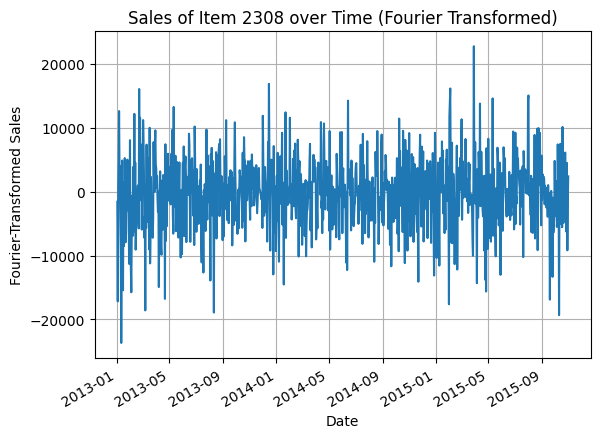

In [53]:
# Specify the item ID you want to plot
item_id = 2308

# Filter the DataFrame for the specific item ID
filtered_data = x[x['item_id'] == item_id]

# Group by 'date' and sum the Fourier-transformed column
# Use [1:] to exclude the first value (if that’s the intention)
fourier_data = filtered_data.groupby('date')['item_cnt_month_fourier'].sum()[1:]

# Plot the data
fourier_data.plot()
plt.title(f'Sales of Item {item_id} over Time (Fourier Transformed)')
plt.xlabel('Date')
plt.ylabel('Fourier-Transformed Sales')
plt.grid()
plt.show()


In [54]:
# adh test on fourier transformed data

from statsmodels.tsa.stattools import adfuller

# print the results
print('ADF Statistic:', adfuller(fourier_data)[0])
print('p-value:', adfuller(fourier_data)[1])
print('Critical Values:', adfuller(fourier_data)[4])

ADF Statistic: -30.83799724390505
p-value: 0.0
Critical Values: {'1%': -3.436972562223603, '5%': -2.864463856182476, '10%': -2.5683268054280175}


/Users/ilyeslenoob/Sales-Prediction-with-Deep-Learning/venv/lib/python3.13/site-packages/pandas/core/series.py:1031: ComplexWarning:

Casting complex values to real discards the imaginary part

/Users/ilyeslenoob/Sales-Prediction-with-Deep-Learning/venv/lib/python3.13/site-packages/pandas/core/series.py:1031: ComplexWarning:

Casting complex values to real discards the imaginary part

/Users/ilyeslenoob/Sales-Prediction-with-Deep-Learning/venv/lib/python3.13/site-packages/pandas/core/series.py:1031: ComplexWarning:

Casting complex values to real discards the imaginary part



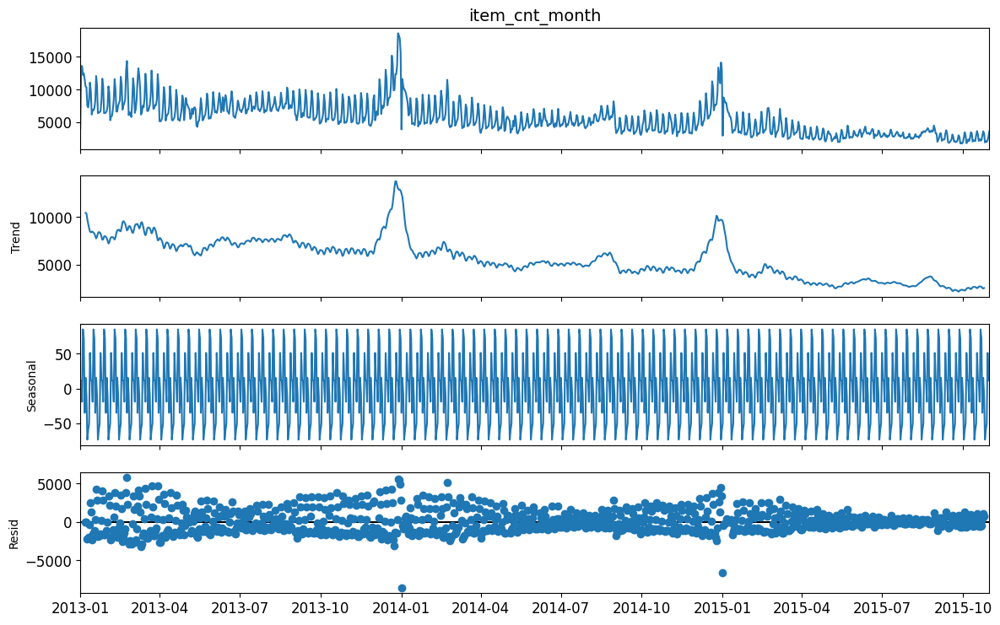

In [110]:
from statsmodels.tsa.seasonal import seasonal_decompose

decomposition = seasonal_decompose(x.groupby('date')['item_cnt_month'].sum(), model='additive', period=12)

fig = decomposition.plot()
fig.set_size_inches(12, 8)
plt.show()

/home/ilyes/Bureau/Sales-Prediction-with-Deep-Learning/venv/lib/python3.10/site-packages/pandas/core/series.py:1031: ComplexWarning:

Casting complex values to real discards the imaginary part



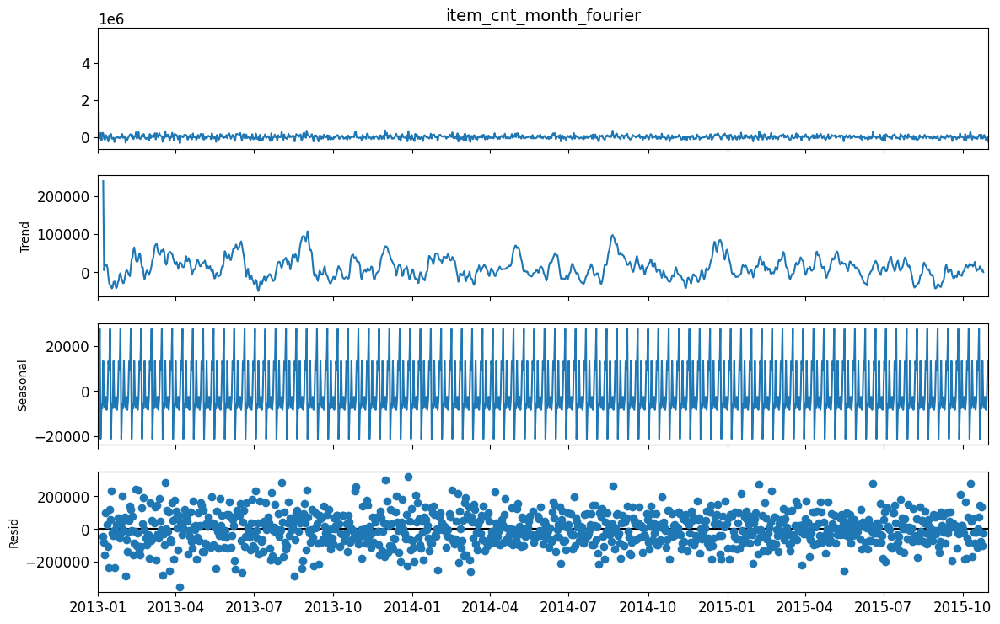

In [112]:
decomposition = seasonal_decompose(x.groupby('date')['item_cnt_month_fourier'].sum(), model='additive', period=12)

fig = decomposition.plot()
fig.set_size_inches(12, 8)
plt.show()

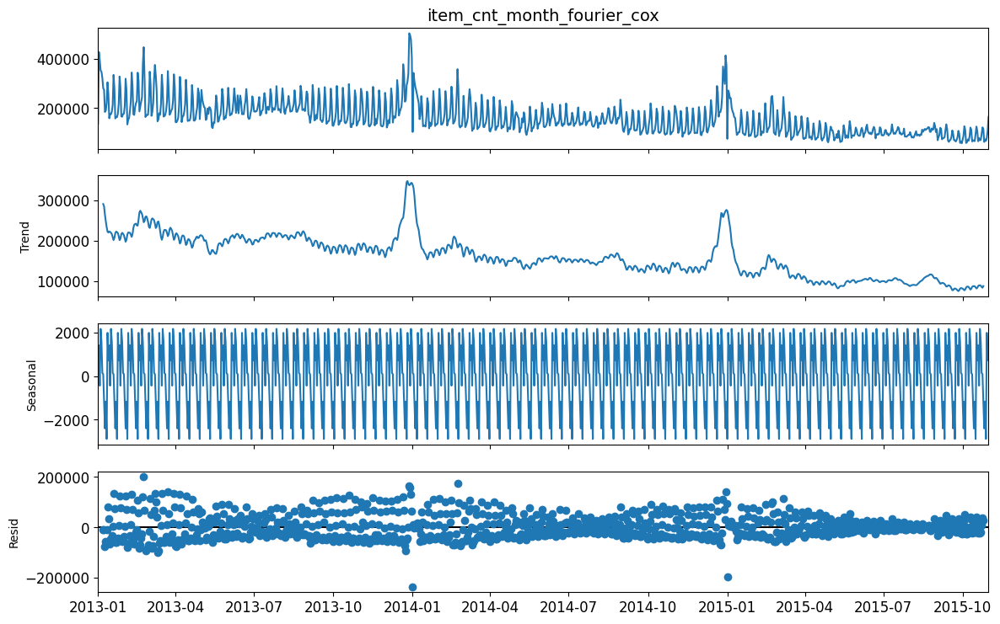

In [115]:
decomposition = seasonal_decompose(x.groupby('date')['item_cnt_month_fourier_cox'].sum(), model='additive', period=12)

fig = decomposition.plot()
fig.set_size_inches(12, 8)
plt.show()

In [118]:
# adh test on fourier cox transformed data

print('ADF Statistic on Fourier x BoxCox Transformation :', adfuller(x.groupby('date')['item_cnt_month_fourier_cox'].sum())[0])
print('p-value:', adfuller(x.groupby('date')['item_cnt_month_fourier_cox'].sum())[1])
print('Critical Values:', adfuller(x.groupby('date')['item_cnt_month_fourier_cox'].sum())[4])


ADF Statistic on Fourier x BoxCox Transformation : -2.926775309337875
p-value: 0.04232181608052376
Critical Values: {'1%': -3.436828225807217, '5%': -2.8644002004847144, '10%': -2.568292900881126}


In [119]:
# adh test on fourier transformed data

print('ADF Statistic on Fourier Transformation :', adfuller(x.groupby('date')['item_cnt_month_fourier'].sum())[0])
print('p-value:', adfuller(x.groupby('date')['item_cnt_month_fourier'].sum())[1])
print('Critical Values:', adfuller(x.groupby('date')['item_cnt_month_fourier'].sum())[4])


/home/ilyes/Bureau/Sales-Prediction-with-Deep-Learning/venv/lib/python3.10/site-packages/pandas/core/series.py:1031: ComplexWarning:

Casting complex values to real discards the imaginary part

/home/ilyes/Bureau/Sales-Prediction-with-Deep-Learning/venv/lib/python3.10/site-packages/pandas/core/series.py:1031: ComplexWarning:

Casting complex values to real discards the imaginary part



ADF Statistic on Fourier Transformation : -63.75039813871493
p-value: 0.0
Critical Values: {'1%': -3.4366961996098264, '5%': -2.8643419712141074, '10%': -2.5682618869934934}


/home/ilyes/Bureau/Sales-Prediction-with-Deep-Learning/venv/lib/python3.10/site-packages/pandas/core/series.py:1031: ComplexWarning:

Casting complex values to real discards the imaginary part



In [120]:
# adh test on log transformed data

print('ADF Statistic on Log Transformation :', adfuller(x.groupby('date')['item_cnt_month_log'].sum())[0])
print('p-value:', adfuller(x.groupby('date')['item_cnt_month_log'].sum())[1])
print('Critical Values:', adfuller(x.groupby('date')['item_cnt_month_log'].sum())[4])


ADF Statistic on Log Transformation : -2.800274045075771
p-value: 0.05823463334186797
Critical Values: {'1%': -3.436828225807217, '5%': -2.8644002004847144, '10%': -2.568292900881126}


In [121]:
# adh test on the original data

print('ADF Statistic on Original Data :', adfuller(x.groupby('date')['item_cnt_month'].sum())[0])
print('p-value:', adfuller(x.groupby('date')['item_cnt_month'].sum())[1])
print('Critical Values:', adfuller(x.groupby('date')['item_cnt_month'].sum())[4])

ADF Statistic on Original Data : -2.768780632648782
p-value: 0.06287346437790772
Critical Values: {'1%': -3.436828225807217, '5%': -2.8644002004847144, '10%': -2.568292900881126}


In [122]:
# adh test on boxcox transformed data

print('ADF Statistic on BoxCox Transformation :', adfuller(x.groupby('date')['item_cnt_month_cox'].sum())[0])
print('p-value:', adfuller(x.groupby('date')['item_cnt_month_cox'].sum())[1])
print('Critical Values:', adfuller(x.groupby('date')['item_cnt_month_cox'].sum())[4])


ADF Statistic on BoxCox Transformation : -2.863419386498462
p-value: 0.049770189186977266
Critical Values: {'1%': -3.436828225807217, '5%': -2.8644002004847144, '10%': -2.568292900881126}


In [77]:
# apply diff on the item_cnt_month column

x['item_cnt_month_diff'] = x.groupby('date')['item_cnt_month'].diff()

# Perform ADF test on the differenced data
adf_result = adfuller(x.groupby('date')['item_cnt_month_diff'].sum().dropna())
print('ADF Statistic on Diff Aggregated Data:', adf_result[0])
print('p-value:', adf_result[1])
print('Critical Values:', adf_result[4])

ADF Statistic on Diff Aggregated Data: -31.793356619692943
p-value: 0.0
Critical Values: {'1%': -3.4366961996098264, '5%': -2.8643419712141074, '10%': -2.5682618869934934}


In [79]:
x.drop(['item_cnt_day_log', 'item_cnt_day_cox', 'item_cnt_month_log', 'item_cnt_month_cox', 'item_cnt_month_fourier'],axis=1,inplace=True)

## Analysis of ADF Test Results for Different Transformations

1. ADF Test on Original Data

    ADF Statistic: -2.769
    p-value: 0.0629
    Critical Values:
        1%: -3.437
        5%: -2.864
        10%: -2.568

Interpretation:

    The ADF statistic is greater than the critical value at the 5% significance level, meaning we fail to reject the null hypothesis of non-stationarity.
    The p-value is slightly above 0.05, indicating a weak rejection of the null hypothesis. The data is borderline stationary, meaning there may still be some trend or seasonality in the data.

2. ADF Test on Log Transformation

    ADF Statistic: -2.800
    p-value: 0.0582
    Critical Values:
        1%: -3.437
        5%: -2.864
        10%: -2.568

Interpretation:

    The ADF statistic is still above the critical value at 5%, so we fail to reject the null hypothesis of non-stationarity.
    The p-value is still above 0.05, similar to the original data. Therefore, the log transformation didn’t improve stationarity. It doesn't seem to have any significant effect on making the series more stationary.

3. ADF Test on Box-Cox Transformation

    ADF Statistic: -2.863
    p-value: 0.0498
    Critical Values:
        1%: -3.437
        5%: -2.864
        10%: -2.568

Interpretation:

    The ADF statistic is slightly below the 5% critical value, and the p-value is just under 0.05, which means that the null hypothesis of non-stationarity is rejected at the 5% significance level.
    This suggests that the Box-Cox transformation has helped make the data more stationary, and it performs better than the original and log-transformed data.

4. ADF Test on Fourier Transformation

    ADF Statistic: -63.750
    p-value: 0.0
    Critical Values:
        1%: -3.437
        5%: -2.864
        10%: -2.568

Interpretation:

    The ADF statistic is extremely negative, much lower than the critical values at all significance levels, and the p-value is 0.0, which means we strongly reject the null hypothesis of non-stationarity.
    This suggests that the Fourier transformation has made the data stationary to a high degree. However, this result is extreme, and further analysis would be needed to ensure that no overfitting or over-transformation has occurred.

5. ADF Test on Fourier + Box-Cox Transformation

    ADF Statistic: -2.927
    p-value: 0.0423
    Critical Values:
        1%: -3.437
        5%: -2.864
        10%: -2.568

Interpretation:

    The ADF statistic is below the 5% critical value, and the p-value is just below 0.05, meaning the null hypothesis of non-stationarity is rejected at the 5% level.
    This suggests that combining Fourier with Box-Cox has made the data stationary, but the ADF statistic is not as extreme as with just Fourier transformation. It shows a more moderate transformation, and the result is less extreme compared to Fourier alone.

6. ADF Test on Differenced Aggregated Data

    ADF Statistic: -31.793
    p-value: 0.0
    Critical Values:
        1%: -3.437
        5%: -2.864
        10%: -2.568

Interpretation:

    The ADF statistic is extremely negative, much lower than the critical values at all significance levels, and the p-value is 0.0, meaning we strongly reject the null hypothesis of non-stationarity.
    The differenced aggregated data is highly stationary and has the most extreme ADF result, which indicates that differencing has been very effective in removing trends or seasonality in the data.


## Best Transformation: Differenced Aggregated Data

* The differenced aggregated data has the most compelling result, with a very low ADF statistic (-31.793) and a p-value of 0.0. This indicates that differencing the aggregated data has made the series highly stationary.

* Reason: Since differencing is the most commonly used method to make data stationary and the results are very strong here, it is the best option for further analysis or modeling (especially for time series models like ARIMA).

# Analysis on : `item_cnt_day`

In [ ]:
# adh test on item_cnt_day column
print('ADF Statistic on original item_cnt_day column :', adfuller(x.groupby('date')['item_cnt_day'].sum())[0])
print('p-value:', adfuller(x.groupby('date')['item_cnt_day'].sum())[1])
print('Critical Values:', adfuller(x.groupby('date')['item_cnt_day'].sum())[4])

ADF Statistic on original item_cnt_day column : -2.836981629657736
p-value: 0.05318228960590949
Critical Values: {'1%': -3.436828225807217, '5%': -2.8644002004847144, '10%': -2.568292900881126}


In [ ]:
x['item_cnt_day_log'] = np.log1p(x['item_cnt_day'])
print('ADF Statistic on Log Transformation :', adfuller(x.groupby('date')['item_cnt_day_log'].sum())[0])
print('p-value:', adfuller(x.groupby('date')['item_cnt_day_log'].sum())[1])
print('Critical Values:', adfuller(x.groupby('date')['item_cnt_day_log'].sum())[4])

ADF Statistic on Log Transformation : -2.8369816296577386
p-value: 0.05318228960590923
Critical Values: {'1%': -3.436828225807217, '5%': -2.8644002004847144, '10%': -2.568292900881126}


In [ ]:
x['item_cnt_day_fourier'] = fft(x['item_cnt_day'].to_numpy())
print('ADF Statistic on Fourier Transformation :', adfuller(x.groupby('date')['item_cnt_day_fourier'].sum())[0])
print('p-value:', adfuller(x.groupby('date')['item_cnt_day_fourier'].sum())[1])
print('Critical Values:', adfuller(x.groupby('date')['item_cnt_day_fourier'].sum())[4])

/home/ilyes/Bureau/Sales-Prediction-with-Deep-Learning/venv/lib/python3.10/site-packages/pandas/core/series.py:1031: ComplexWarning: Casting complex values to real discards the imaginary part
  arr = np.asarray(values, dtype=dtype)
/home/ilyes/Bureau/Sales-Prediction-with-Deep-Learning/venv/lib/python3.10/site-packages/pandas/core/series.py:1031: ComplexWarning: Casting complex values to real discards the imaginary part
  arr = np.asarray(values, dtype=dtype)


ADF Statistic on Fourier Transformation : -0.6771784440169804
p-value: 0.8525726141054097
Critical Values: {'1%': -3.436821814402523, '5%': -2.8643973728364043, '10%': -2.5682913948189823}


/home/ilyes/Bureau/Sales-Prediction-with-Deep-Learning/venv/lib/python3.10/site-packages/pandas/core/series.py:1031: ComplexWarning: Casting complex values to real discards the imaginary part
  arr = np.asarray(values, dtype=dtype)


In [108]:
# Aggregate the data by date
aggregated_data = x.groupby('date')['item_cnt_day'].sum()

In [111]:
aggregated_data.count()

1034

In [ ]:
# Apply differencing on the aggregated data
aggregated_data_diff = aggregated_data.diff().dropna()

In [113]:
aggregated_data_diff

date
2013-01-02    3889.0
2013-01-03    -205.0
2013-01-04    -513.0
2013-01-05       3.0
2013-01-06    -343.0
               ...  
2015-10-27     117.0
2015-10-28     -80.0
2015-10-29     151.0
2015-10-30     308.0
2015-10-31     417.0
Name: item_cnt_day, Length: 1033, dtype: float64

In [ ]:
# Merge the differenced aggregated data back to the original dataset by 'date'
x = x.merge(aggregated_data_diff, on='date', how='left', suffixes=('', '_diff'))

In [116]:
# Perform the ADF test on the differenced aggregated data
adf_result = adfuller(aggregated_data_diff)
print('ADF Statistic on Diff Aggregated Data:', adf_result[0])
print('p-value:', adf_result[1])
print('Critical Values:', adf_result[4])

ADF Statistic on Diff Aggregated Data: -8.58313298829586
p-value: 7.632561002678923e-14
Critical Values: {'1%': -3.436828225807217, '5%': -2.8644002004847144, '10%': -2.568292900881126}


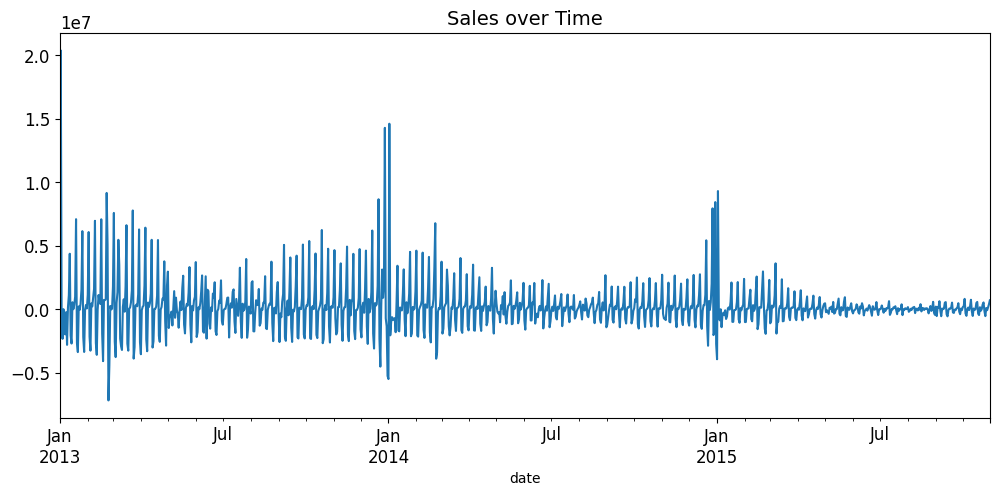

In [117]:
# plot the item_cnt_day_diff over time in general
x.groupby('date')['item_cnt_day_diff'].sum().plot()
plt.title('Sales over Time')
plt.show()

In [118]:
x.columns

Index(['date', 'year', 'month', 'date_block_num', 'shop_id', 'item_id',
       'item_price', 'item_cnt_day', 'sales', 'item_cnt_month',
       'item_cnt_month_diff', 'item_cnt_day_log', 'item_cnt_day_fourier',
       'item_cnt_day_lag1', 'item_cnt_day_diff'],
      dtype='object')

In [119]:
cols_to_drop = ['item_cnt_day_log', 'item_cnt_day_fourier', 'item_cnt_day_lag1']

x.drop(cols_to_drop,axis=1,inplace=True)

# ADF Test Analysis on item_cnt_day Transformations

You've applied the Augmented Dickey-Fuller (ADF) test on several transformations of the item_cnt_day data, and here’s a breakdown of the results for each transformation:
1. ADF Test on Original item_cnt_day Column

    ADF Statistic: -2.83698
    p-value: 0.0532
    Critical Values:
        1%: -3.4368
        5%: -2.8644
        10%: -2.5683

Interpretation:

    The ADF statistic (-2.837) is greater than the critical value at the 5% significance level (-2.864). This suggests that the null hypothesis of non-stationarity cannot be rejected at the 5% significance level.
    The p-value (0.0532) is just above the typical 0.05 threshold, which indicates that the series is borderline stationary. However, since it is just above the threshold, it suggests there is some evidence for mild stationarity.

Conclusion: The original item_cnt_day series appears to be slightly non-stationary, with weak evidence to reject non-stationarity at the 5% level.
2. ADF Test on Aggregated item_cnt_day by Date

    ADF Statistic: -2.83698
    p-value: 0.0532
    Critical Values:
        1%: -3.4368
        5%: -2.8644
        10%: -2.5683

Interpretation:

    The results for the aggregated data (item_cnt_day grouped by date) are identical to the original data.
    Since the ADF statistic and p-value didn’t change, it suggests that the aggregation didn’t significantly improve the stationarity of the series.

Conclusion: Aggregating by date has no effect on the stationarity of the series.
3. ADF Test on Fourier Transformation

    ADF Statistic: -0.67718
    p-value: 0.8526
    Critical Values:
        1%: -3.4368
        5%: -2.8644
        10%: -2.5683

Interpretation:

    The ADF statistic (-0.677) is much higher than the critical values at all significance levels (1%, 5%, and 10%).
    The p-value (0.8526) is very high, which means the null hypothesis of non-stationarity cannot be rejected. The data is likely non-stationary after the Fourier transformation.

Conclusion: The Fourier transformation worsened the stationarity of the data. It should be avoided as it leads to highly non-stationary results.
4. ADF Test on Differenced Aggregated Data

    ADF Statistic: -8.5831
    p-value: 7.6326e-14
    Critical Values:
        1%: -3.4368
        5%: -2.8644
        10%: -2.5683

Interpretation:

    The ADF statistic (-8.5831) is much smaller (more negative) than the critical values at all significance levels, suggesting that the differenced data is highly stationary.
    The p-value (7.6326e-14) is extremely small, providing strong evidence against the null hypothesis of non-stationarity. This indicates strong stationarity in the differenced data.

Conclusion: The differenced aggregated data is highly stationary, and it is the best transformation among those tested.

In [121]:
# save the cleaned data
x.to_csv('../data/cleaned_sales_train.csv',index=False)